<a href="https://colab.research.google.com/github/doganmelis/CS210-Intro-to-Data-Science/blob/main/Project_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Airbnb Location-Price Relationship - Group 11

Group Members:



*   Melis Doğan
*   Eren Elçin


### Introduction and Definition

When we look at the Airbnb dataset it can clearly be seen that there are certain pricing gaps when it comes to some regions of NYC as some are plateaued in a higher pricing range whereas some are varied on the lower side depending on their regions. What we are aiming to find are the factors that caused such differentiated plateaus by linking the data obtained from the Airbnb dataset with the datas we believe may cause such gaps in pricing from the dataset retrieved from NYC Open Data.

### Utilized Datasets

####[Airport Points ](https://data.cityofnewyork.us/City-Government/Airport-Point/f6st-pb23) 

This dataset contains the airport points at NYC. Because of the nature of the airports there is not much data in this dataset. There is only 2 datas in the dataset but because airports causes significant amount of change in price as increase around the area it belongs to. We decided that this data would be of great importance also. Moreover customers of Airbnb are mainly people who are looking for places to stay because they are far from home like tourists, so we conclude that they might want to stay closer to airport areas because it is more convenient. This results in an increased demand in places around the airport which also leads to increase in prices at those areas.

In [ ]:
from google.colab import drive
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [ ]:
from os.path import join 
import pandas as pd
import matplotlib.pyplot as plt

<BarContainer object of 5 artists>

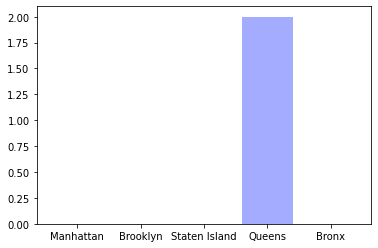

In [ ]:
data_airport = {'Manhattan': 0, 'Brooklyn': 0, 'Staten Island': 0,'Queens': 2,  'Bronx': 0}

names_airport = list(data_airport.keys())
values_airport = list(data_airport.values())

plt.bar(names_airport, values_airport,color='#a3acff')

####[Facilities Database - Shapefile ](https://data.cityofnewyork.us/City-Government/Facilities-Database-Shapefile/2fpa-bnsx) 

The Facilities Database captures the locations and descriptions of public and private facilities ranging from the provision of social services, recreation, education, to solid waste management. People need various infrastructures to live their daily life comfortably. Higher the quality, capacity and way of operation of these infrastructures, higher the quality of life of the citizens have per area. People would want to live in areas like this and this demand would increase the price of lodging and value of structure around that area. We thought that this will also increase the cost and customer preference of Airbnb lodging in that area. 

In [ ]:
path_prefix = "/content/drive/My Drive"
fname = "facilities.csv"
df2 = pd.read_csv(join(path_prefix, fname))

df2.head()

,the_geom,FACNAME,STREETNAME,ADDRESSNUM,ADDRESS,CITY,ZIPCODE,BORO,BOROCODE,BIN,BBL,COMMBOARD,NTA,COUNCIL,SCHOOLDIST,POLICEPRCT,CENSTRACT,FACTYPE,FACSUBGRP,FACGROUP,FACDOMAIN,SERVAREA,OPNAME,OPABBREV,OPTYPE,OVERAGENCY,OVERABBREV,OVERLEVEL,CAPACITY,CAPTYPE,PROPTYPE,LATITUDE,LONGITUDE,XCOORD,YCOORD,DATASOURCE,UID
0,POINT (-73.8817555919544 40.70492273997485),"""UNCLE"" VITO F. MARANZANO GLENDALE PLAYGROUND",CENTRAL AVENUE,2869,2869 CENTRAL AVENUE,RIDGEWOOD,11385.0,Queens,4,4089051,4036610001,405,QN19,30,104.0,24,62500,PLAYGROUND,RECREATION AND WATERFRONT SITES,PARKS AND PLAZAS,"PARKS, GARDENS, AND HISTORICAL SITES",Local,NYC Department of Parks and Recreation,NYCDPR,Public,NYC Department of Parks and Recreation,NYCDPR,City,0,NaN,NaN,40.704931,-73.881757,1.017034e+06,196123.976233,dpr_parksproperties,9a6c9e9a071985bc5d654644b1c175f5
1,POINT (-73.9686854216542 40.79271678150397),'THE STUDIO SCHOOL',WEST 95 STREET,117,117 WEST 95 STREET,NEW YORK,10025.0,Manhattan,1,1032605,1012260025,107,MN12,6,24.0,3,18100,DAY CARE,DAY CARE,DAY CARE AND PRE-KINDERGARTEN,"EDUCATION, CHILD WELFARE, AND YOUTH",Local,'The Studio School',Non-public,Non-public,NYC Department of Health and Mental Hygiene,NYCDOHMH,City,0,NaN,NaN,40.792725,-73.968687,9.929205e+05,228089.599338,dohmh_daycare,f064e49c2b92f9dde031ca5af0574eba
2,POINT (-73.72897763552493 40.73705740305515),0230 - BERNARD M. FINESON DDSO,WINCHESTER BOULEVARD,80-45,80-45 WINCHESTER BOULEVARD,QUEENS VILLAGE,11427.0,Queens,4,4537294,4078800400,413,QN43,23,105.0,26,156700,PROGRAMS FOR PEOPLE WITH DISABILITIES,PROGRAMS FOR PEOPLE WITH DISABILITIES,HUMAN SERVICES,HEALTH AND HUMAN SERVICES,Local,0230 - Bernard M. Fineson Ddso,Non-public,Non-public,NYS Office for People With Developmental Disab...,NYSOPWDD,State,0,NaN,NaN,40.737066,-73.728979,1.059357e+06,207925.687994,nysopwdd_providers,37ac7856d76cebee4ec9395c5b693d53
3,POINT (-73.86541683930989 40.65609936278035),0235 - BROOKLYN DDSO,FOUNTAIN AVENUE,888,888 FOUNTAIN AVENUE,BROOKLYN,11208.0,Brooklyn,3,3327531,3045860300,305,BK82,42,75.0,19,107000,PROGRAMS FOR PEOPLE WITH DISABILITIES,PROGRAMS FOR PEOPLE WITH DISABILITIES,HUMAN SERVICES,HEALTH AND HUMAN SERVICES,Local,0235 - Brooklyn Ddso,Non-public,Non-public,NYS Office for People With Developmental Disab...,NYSOPWDD,State,0,NaN,NaN,40.656108,-73.865418,1.021591e+06,178342.765914,nysopwdd_providers,420eff2cf4ef35f2fa9a2b5ff1a6e443
4,POINT (-74.01199216585837 40.70533936563152),0265 - METRO NY DDSO,BEAVER STREET,25,25 BEAVER STREET,NEW YORK,10004.0,Manhattan,1,1000817,1000240001,101,MN25,1,1.0,2,900,PROGRAMS FOR PEOPLE WITH DISABILITIES,PROGRAMS FOR PEOPLE WITH DISABILITIES,HUMAN SERVICES,HEALTH AND HUMAN SERVICES,Local,0265 - Metro Ny Ddso,Non-public,Non-public,NYS Office for People With Developmental Disab...,NYSOPWDD,State,0,NaN,NaN,40.705348,-74.011994,9.809247e+05,196253.864432,nysopwdd_providers,d14d69171f0418b1a8574ad5c48e4c19


<BarContainer object of 5 artists>

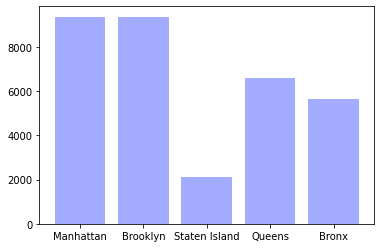

In [ ]:
list_of_brooklyn = df2.loc[df2['BORO'] == 'Brooklyn']
num_brooklyn3 = len(list_of_brooklyn)

list_of_manhattan = df2.loc[df2['BORO'] == 'Manhattan']
num_manhattan3 = len(list_of_manhattan)

list_of_bronx = df2.loc[df2['BORO'] == 'Bronx']
num_bronx3 = len(list_of_bronx)

list_of_queens = df2.loc[df2['BORO'] == 'Queens']
num_queens3 = len(list_of_queens)

list_of_statenisland = df2.loc[df2['BORO'] == 'Staten Island']
num_statenisland3 = len(list_of_statenisland)

data_facilities = {'Manhattan': num_manhattan3, 'Brooklyn': num_brooklyn3, 'Staten Island': num_statenisland3,'Queens': num_queens3,  'Bronx': num_bronx3}

names_facilities = list(data_facilities.keys())
values_facilities = list(data_facilities.values())

plt.bar(names_facilities, values_facilities,color='#a3acff')

In [ ]:
import folium

lat = df2["LATITUDE"].mean()
lng = df2["LONGITUDE"].mean()
m = folium.Map(location=[lat, lng], zoom_start=12, tiles = "Stamen Terrain")
locs = df2[["LATITUDE", "LONGITUDE"]].values
for i in locs :
  folium.CircleMarker(location=i, radius=3, color="black").add_to(m)
m

####[Civilian Complaint Review Board - Complaints Received](https://data.cityofnewyork.us/Public-Safety/Civilian-Complaint-Review-Board-CCRB-Complaints-Re/63nx-cpi9) 

NYC OpenData description: "The New York City Civilian Complaint Review Board is an independent agency. It is empowered to receive, investigate, mediate, hear, make findings, and recommend action on complaints against New York City police officers alleging the use of excessive or unnecessary force, abuse of authority, discourtesy, or the use of offensive language. The Board’s investigative staff, composed entirely of civilian employees, conducts investigations in an impartial fashion. The Board forwards its findings to the police commissioner." We wanted to see whether or not there is a link between the neighbourhoods general safety and its prices. We thought that better the enforcement of law the higher the prestige and value of that area increases. People tend to live in areas that are safer and better compared to others if they can afford to live there. So we thought that customers that have higher budgets compared to other customers would choose more costly options but better and higher quality locations. 

In [ ]:
path_prefix = "/content/drive/My Drive"
fname = "Civilian_Complaint_Review_Board__CCRB__-_Complaints_Received.csv"
df0 = pd.read_csv(join(path_prefix, fname))

df0.head()

,Extract Run Date,Randomized Id,CCRB Received Year,Days Between Incident Date and Received Date,Case Type,Complaint Received Place,Complaint Received Mode,Borough Of Incident,Patrol Borough Of Incident,Reason For Initial Contact
0,05/25/2018,1,2000,2.0,IAB,CCRB,Phone,Bronx,Bronx,PD suspected C/V of violation/crime - street
1,05/25/2018,2,2000,86.0,OCD,Other NYPD unit,In-person,Brooklyn,Brooklyn North,Parking violation
2,05/25/2018,3,2000,0.0,OCD,CCRB,Phone,Queens,Other,NaN
3,05/25/2018,4,2000,0.0,OCD,Other NYPD unit,Phone,Bronx,Bronx,NaN
4,05/25/2018,5,2000,117.0,OCD,CCRB,Phone,Manhattan,Manhattan North,Traffic accident


<BarContainer object of 5 artists>

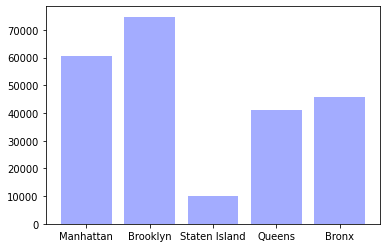

In [ ]:
list_of_brooklyn = df0.loc[df0['Borough Of Incident'] == 'Brooklyn']
num_brooklyn2 = len(list_of_brooklyn)

list_of_manhattan = df0.loc[df0['Borough Of Incident'] == 'Manhattan']
num_manhattan2 = len(list_of_manhattan)

list_of_bronx = df0.loc[df0['Borough Of Incident'] == 'Bronx']
num_bronx2 = len(list_of_bronx)

list_of_queens = df0.loc[df0['Borough Of Incident'] == 'Queens']
num_queens2 = len(list_of_queens)

list_of_statenisland = df0.loc[df0['Borough Of Incident'] == 'Staten Island']
num_statenisland2 = len(list_of_statenisland)

data_civillian = {'Manhattan': num_manhattan2, 'Brooklyn': num_brooklyn2, 'Staten Island': num_statenisland2,'Queens': num_queens2,  'Bronx': num_bronx2}

names_civillian = list(data_civillian.keys())
values_civillian = list(data_civillian.values())

plt.bar(names_civillian, values_civillian,color='#a3acff')

####[NYC Permitted Event Information](https://data.cityofnewyork.us/City-Government/NYC-Permitted-Event-Information/tvpp-9vvx) 

NYC OpenData description,"This list contains information on approved event applications that will occur within the next month. Please note that Permitted Film Events only reflect those permits which will impact one or more streets for at least five days.". The reason why we chosed this dataset is because the regions where the events are usually takes place is the regions where the entertainment centers are located in. For example: Kadiköy, Beşiktaş, Üsküdar. We think that the rents and values ​​of buildings in such regions are higher compared to other regions and we estimate that this increase in prices has a similar effect on Airbnb renting fees.


In [ ]:
path_prefix = "/content/drive/My Drive"
fname = "NYC_Permitted_Event_Information.csv"
df1 = pd.read_csv(join(path_prefix, fname))

df1.head()

,Event ID,Event Name,Start Date/Time,End Date/Time,Event Agency,Event Type,Event Borough,Event Location,Event Street Side,Street Closure Type,Community Board,Police Precinct
0,514575,Celebration,06/28/2020 05:00:00 PM,06/28/2020 06:00:00 PM,Parks Department,Special Event,Manhattan,Central Park: Bethesda Fountain Terrace,NaN,NaN,"64,","22,"
1,514577,Music is My Life,06/06/2020 03:00:00 PM,06/06/2020 07:00:00 PM,Parks Department,Special Event,Brooklyn,Coney Island Beach & Boardwalk: W 19 St Perfor...,NaN,NaN,"13,","60,"
2,514579,Picnic,08/08/2020 10:00:00 AM,08/08/2020 07:00:00 PM,Parks Department,Special Event,Queens,Cunningham Park: Picnic Green 2,NaN,NaN,"8,","107,"
3,514580,Miscellaneous,06/19/2020 09:00:00 AM,06/19/2020 02:00:00 PM,Parks Department,Special Event,Queens,"Rosemary's Playground: Rosemary's Playground ,...",NaN,NaN,"05, 5,","104,"
4,514585,Miscellaneous,06/05/2020 09:00:00 AM,06/05/2020 02:00:00 PM,Parks Department,Special Event,Brooklyn,"McCarren Park: Track-01 ,McCarren Park: Soccer...",NaN,NaN,"01,","94,"


<BarContainer object of 5 artists>

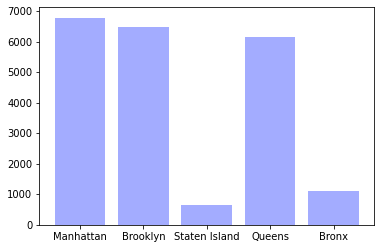

In [ ]:
list_of_brooklyn = df1.loc[df1['Event Borough'] == 'Brooklyn']
num_brooklyn1 = len(list_of_brooklyn)

list_of_manhattan = df1.loc[df1['Event Borough'] == 'Manhattan']
num_manhattan1 = len(list_of_manhattan)

list_of_bronx = df1.loc[df1['Event Borough'] == 'Bronx']
num_bronx1 = len(list_of_bronx)

list_of_queens = df1.loc[df1['Event Borough'] == 'Queens']
num_queens1 = len(list_of_queens)

list_of_statenisland = df1.loc[df1['Event Borough'] == 'Staten Island']
num_statenisland1 = len(list_of_statenisland)

data_permitted = {'Manhattan': num_manhattan1, 'Brooklyn': num_brooklyn1, 'Staten Island': num_statenisland1,'Queens': num_queens1,  'Bronx': num_bronx1}

names_permitted = list(data_permitted.keys())
values_permitted = list(data_permitted.values())


plt.bar(names_permitted, values_permitted,color='#a3acff')

####[Sidewalk Café Regulations GIS: Shapefile ](https://data.cityofnewyork.us/City-Government/Sidewalk-Caf-Regulations-GIS-Shapefile/qsuf-mgjh)

NYC OpenData description,"This feature class is a spatial representation of the Sidewalk Cafe regulations in the New York City Zoning Resolution, Chapter 1, Article 4.” [More than 450 million cups of coffee are consumed in the United States every day.](https://recipes.howstuffworks.com/coffee-facts.htm) Cafes are places for young generation to socialize, convineint places to buy coffee for people who don't have time to prepare coffee before going to work or peacfull places to read and study. Many people show great interest to cafes. So we thought this popularity might create a demand to live in places close to cafes which will result increase in housing prices. This would result increase in Airbnb prices.

In [ ]:
path_prefix = "/content/drive/My Drive"
fname = "nysidewalkcafe.csv"
df4 = pd.read_csv(join(path_prefix, fname))

df4.head()

,the_geom,Shape_Leng,CafeType
0,MULTILINESTRING ((-74.10218629584185 40.560515...,521.517006,All Cafes
1,MULTILINESTRING ((-73.92023233516775 40.560678...,1865.622323,All Cafes
2,MULTILINESTRING ((-74.11231115997637 40.561628...,4771.835088,All Cafes
3,MULTILINESTRING ((-73.914986311731 40.56165686...,854.548726,All Cafes
4,MULTILINESTRING ((-73.91285895092047 40.561800...,1004.937613,All Cafes


In [ ]:
x = []
lat = []
lon = []

# For each row in a varible,
for row in df4['the_geom']:
    
    try:
        x.append(row.split(' ')[0])
        lat.append(row.split(' ')[1])
        lon.append(row.split(' ')[2])

    except:
        lat.append(np.NaN)
        lon.append(np.NaN)

df4['x'] = x
df4['latitude'] = lat
df4['longitude'] = lon
df4['latitude'] = df4['latitude'].str.replace('(', '')
df4['latitude'] = df4['latitude'].str.replace(',', '')
df4['latitude'] = df4['latitude'].astype(float)
df4['longitude'] = df4['longitude'].str.replace(')', '')
df4['longitude'] = df4['longitude'].str.replace(',', '')
df4['longitude'] = df4['longitude'].astype(float)
df4.drop(['x','the_geom'], axis=1)
df4

,the_geom,Shape_Leng,CafeType,x,latitude,longitude
0,MULTILINESTRING ((-74.10218629584185 40.560515...,521.517006,All Cafes,MULTILINESTRING,-74.102186,40.560516
1,MULTILINESTRING ((-73.92023233516775 40.560678...,1865.622323,All Cafes,MULTILINESTRING,-73.920232,40.560679
2,MULTILINESTRING ((-74.11231115997637 40.561628...,4771.835088,All Cafes,MULTILINESTRING,-74.112311,40.561629
3,MULTILINESTRING ((-73.914986311731 40.56165686...,854.548726,All Cafes,MULTILINESTRING,-73.914986,40.561657
4,MULTILINESTRING ((-73.91285895092047 40.561800...,1004.937613,All Cafes,MULTILINESTRING,-73.912859,40.561801
...,...,...,...,...,...,...
20062,MULTILINESTRING ((-73.9727366474592 40.5765216...,559.632457,Not Permitted,MULTILINESTRING,-73.972737,40.576522
20063,MULTILINESTRING ((-74.01136590705582 40.616687...,205.656417,All Cafes,MULTILINESTRING,-74.011366,40.616687
20064,MULTILINESTRING ((-74.00001537389686 40.732164...,395.204417,All Cafes,MULTILINESTRING,-74.000015,40.732164
20065,MULTILINESTRING ((-74.00045390634064 40.731553...,393.858556,All Cafes,MULTILINESTRING,-74.000454,40.731553


In [ ]:
import folium

lat = df4["longitude"].mean()
lng = df4["latitude"].mean()
m = folium.Map(location=[lat, lng], zoom_start=12, tiles = "Stamen Terrain")
locs = df4[["longitude", "latitude"]].values
for i in locs :
  folium.CircleMarker(location=i, radius=3, color="green").add_to(m)
m

####[Subway Entrances](https://data.cityofnewyork.us/Transportation/Subway-Entrances/drex-xx56) 

NYC OpenData description,"Map of NYC Subway Entrances". The reason why we chosed this dataset is because we though that housing prices near Subway entraces would be higher because of convenience in transportation. Traffic is a huge problem in big cities like New York. The fact that a person living in New York city does not have(or very less) traffic problems can be considered as luxury which is why prices of buildings around that are is more expensive compared to hard to reach regines of the city.

In [ ]:
path_prefix = "/content/drive/My Drive"
fname = "DOITT_SUBWAY_ENTRANCE_01_13SEPT2010.csv"
df3 = pd.read_csv(join(path_prefix, fname))

df3.head()

,OBJECTID,URL,NAME,the_geom,LINE
0,1734,http://web.mta.info/nyct/service/,Birchall Ave & Sagamore St at NW corner,POINT (-73.86835600032798 40.84916900104506),2-5
1,1735,http://web.mta.info/nyct/service/,Birchall Ave & Sagamore St at NE corner,POINT (-73.86821300022677 40.84912800131844),2-5
2,1736,http://web.mta.info/nyct/service/,Morris Park Ave & 180th St at NW corner,POINT (-73.87349900050798 40.84122300105249),2-5
3,1737,http://web.mta.info/nyct/service/,Morris Park Ave & 180th St at NW corner,POINT (-73.8728919997833 40.84145300067447),2-5
4,1738,http://web.mta.info/nyct/service/,Boston Rd & 178th St at SW corner,POINT (-73.87962300013866 40.84081500075867),2-5


In [ ]:
x = []
lat = []
lon = []

# For each row in a varible,
for row in df3['the_geom']:
    
    try:
        x.append(row.split(' ')[0])
        lat.append(row.split(' ')[1])
        lon.append(row.split(' ')[2])

    except:
        lat.append(np.NaN)
        lon.append(np.NaN)

df3['x'] = x
df3['latitude'] = lat
df3['longitude'] = lon
df3['latitude'] = df3['latitude'].str.replace('(', '')
df3['latitude'] = df3['latitude'].astype(float)
df3['longitude'] = df3['longitude'].str.replace(')', '')
df3['longitude'] = df3['longitude'].astype(float)
df3.drop(['x','the_geom'], axis=1)
df3

,OBJECTID,URL,NAME,the_geom,LINE,x,latitude,longitude
0,1734,http://web.mta.info/nyct/service/,Birchall Ave & Sagamore St at NW corner,POINT (-73.86835600032798 40.84916900104506),2-5,POINT,-73.868356,40.849169
1,1735,http://web.mta.info/nyct/service/,Birchall Ave & Sagamore St at NE corner,POINT (-73.86821300022677 40.84912800131844),2-5,POINT,-73.868213,40.849128
2,1736,http://web.mta.info/nyct/service/,Morris Park Ave & 180th St at NW corner,POINT (-73.87349900050798 40.84122300105249),2-5,POINT,-73.873499,40.841223
3,1737,http://web.mta.info/nyct/service/,Morris Park Ave & 180th St at NW corner,POINT (-73.8728919997833 40.84145300067447),2-5,POINT,-73.872892,40.841453
4,1738,http://web.mta.info/nyct/service/,Boston Rd & 178th St at SW corner,POINT (-73.87962300013866 40.84081500075867),2-5,POINT,-73.879623,40.840815
...,...,...,...,...,...,...,...,...
1923,1928,http://web.mta.info/nyct/service/,2nd Ave & bet 83rd & 84th St,POINT (-73.95281423699555 40.77618770946792),Q,POINT,-73.952814,40.776188
1924,1929,http://web.mta.info/nyct/service/,2nd Ave & 96th St at SW corner,POINT (-73.94747299691045 40.784098884955554),Q,POINT,-73.947473,40.784099
1925,1930,http://web.mta.info/nyct/service/,2nd Ave & 95th St at NW corner,POINT (-73.94761889814153 40.783916088309326),Q,POINT,-73.947619,40.783916
1926,1931,http://web.mta.info/nyct/service/,2nd Ave & 94th St at NE corner,POINT (-73.94772938539093 40.78292438898596),Q,POINT,-73.947729,40.782924


In [ ]:
import folium

lat = df3["longitude"].mean()
lng = df3["latitude"].mean()
m = folium.Map(location=[lat, lng], zoom_start=12, tiles = "Stamen Terrain")
locs = df3[["longitude", "latitude"]].values
for i in locs :
  folium.CircleMarker(location=i, radius=3, color="black").add_to(m)
m

####[NYC Transportation Sites](https://data.cityofnewyork.us/Transportation/Transportation-Sites/hg3c-2jsy) 

In [ ]:
path_prefix = "/content/drive/My Drive"
fname = "Transportation_Sites.csv"
df5 = pd.read_csv(join(path_prefix, fname))
df5 = df5.dropna()
df5.head()

,School_Year,OPT_Code,Name,Affiliation,Site_Type,Street_Address,City,State,Zip,Longitude,Latitude,Door_To_Door_Service,Stop_To_School_Service,Common_Carrier_Svc_Metrocards,Site_Reimbursement,Mid_Day_Service,D2D_Late_Day_Programs,S2S_Late_Day_Programs
0,2016-2017,01001,Comprehensive Kids Devel. Scho,Other Religion,School,101 Norfolk Street,Manhattan,NY,10002.0,-73.987271,40.718791,Yes,No,No,No,No,No,No
1,2016-2017,01569,BARD HS EARLY COLLEGE,Public,School,525 EAST HOUSTON STREET,Manhattan,NY,10002.0,-73.975438,40.718761,Yes,No,Yes,No,No,No,No
2,2016-2017,01600,SATELLITE ACADEMY,Public,School,198 FORSYTH STREET,Manhattan,NY,10002.0,-73.990635,40.722491,No,No,Yes,No,No,No,No
3,2016-2017,01616,COOK CTR GRAMMAR SCHOOL,Nonsectarian,School,219 STANTON STREET,Manhattan,NY,10002.0,-73.982171,40.719442,Yes,No,Yes,No,Yes,No,No
4,2016-2017,01657,MANHATTAN CHARTER SCHOOL,Charter,School,100 ATTORNEY STREET,Manhattan,NY,10002.0,-73.984365,40.718346,Yes,Yes,Yes,No,Yes,No,No


<BarContainer object of 5 artists>

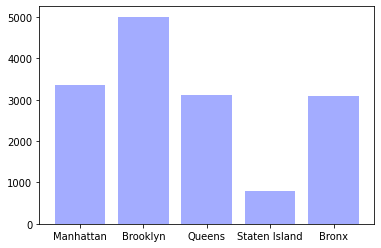

In [ ]:
list_of_brooklyn = df5.loc[df5['City'] == 'Brooklyn']
num_brooklyn4 = len(list_of_brooklyn)

list_of_manhattan = df5.loc[df5['City'] == 'Manhattan']
num_manhattan4 = len(list_of_manhattan)

list_of_bronx = df5.loc[df5['City'] == 'Bronx']
num_bronx4 = len(list_of_bronx)

list_of_queens = df5.loc[df5['City'] == 'Queens']
num_queens4 = len(list_of_queens)

list_of_statenisland = df5.loc[df5['City'] == 'Staten Island']
num_statenisland4 = len(list_of_statenisland)

data_transport = {'Manhattan': num_manhattan4, 'Brooklyn': num_brooklyn4, 'Queens': num_queens4, 'Staten Island': num_statenisland4,  'Bronx': num_bronx4}

names_transport = list(data_transport.keys())
values_transport = list(data_transport.values())


plt.bar(names_transport, values_transport,color='#a3acff')

## Data Exploration

In [ ]:
#OUR MAIN DATA
from os.path import join 
import pandas as pd

path_prefix = "/content/drive/My Drive"
fname = "AB_NYC_2019.csv"
df_main = pd.read_csv(join(path_prefix, fname))

df_main.head()


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [ ]:
df_main.isnull().sum() / df_main.shape[0]

id                                0.000000
name                              0.000327
host_id                           0.000000
host_name                         0.000429
neighbourhood_group               0.000000
neighbourhood                     0.000000
latitude                          0.000000
longitude                         0.000000
room_type                         0.000000
price                             0.000000
minimum_nights                    0.000000
number_of_reviews                 0.000000
last_review                       0.205583
reviews_per_month                 0.205583
calculated_host_listings_count    0.000000
availability_365                  0.000000
dtype: float64

In [ ]:
df_main = df_main.dropna()

In [ ]:
print(df_main["price"].max())
print(df_main["price"].min())
main_mean = sum(df_main["price"])/len(df_main["price"])
main_mean


10000
0


142.33252621004095

In [ ]:
def categorize(dfe):
   
    bins = [0, 100, 200, 300, 400, 10000]
    names = ['low', 'medium', 'medium high', 'high', 'highest']
    a = pd.cut(dfe, bins= bins, labels=names)
    return a

df_main['price_category'] = df_main[['price']].apply(categorize)
df_main = df_main.dropna()
print(df_main)


             id  ... price_category
0          2539  ...         medium
1          2595  ...    medium high
3          3831  ...            low
4          5022  ...            low
5          5099  ...         medium
...         ...  ...            ...
48782  36425863  ...         medium
48790  36427429  ...            low
48799  36438336  ...    medium high
48805  36442252  ...            low
48852  36455809  ...            low

[38811 rows x 17 columns]


Text(0.5, 0.98, 'Price Means In Dollars With Respect To Neighbourhood Groups')

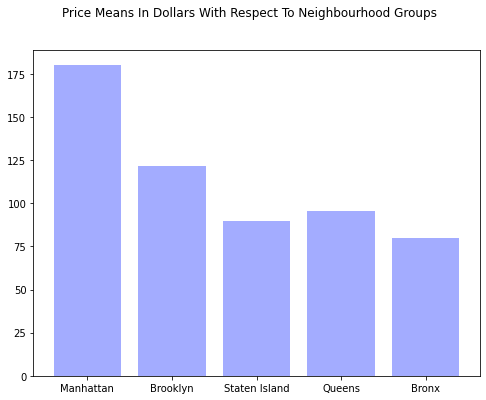

In [ ]:
import matplotlib.pyplot as plt

price_of_brooklyn = df_main.loc[df_main['neighbourhood_group'] == 'Brooklyn', 'price']
mean_brooklyn = sum(price_of_brooklyn)/len(price_of_brooklyn)

price_of_manhattan = df_main.loc[df_main['neighbourhood_group'] == 'Manhattan', 'price']
mean_manhattan = sum(price_of_manhattan)/len(price_of_manhattan)

price_of_bronx = df_main.loc[df_main['neighbourhood_group'] == 'Bronx', 'price']
mean_bronx = sum(price_of_bronx)/len(price_of_bronx)

price_of_queens = df_main.loc[df_main['neighbourhood_group'] == 'Queens', 'price']
mean_queens = sum(price_of_queens)/len(price_of_queens)

price_of_statenisland = df_main.loc[df_main['neighbourhood_group'] == 'Staten Island', 'price']
mean_statenisland = sum(price_of_statenisland)/len(price_of_statenisland)

data = {'Manhattan': mean_manhattan, 'Brooklyn': mean_brooklyn, 'Staten Island': mean_statenisland,'Queens': mean_queens,  'Bronx': mean_bronx}

names = list(data.keys())
values = list(data.values())

fig, axs = plt.subplots(1, 1, figsize=(8, 6), sharey=True) 
plt.bar(names, values,color='#a3acff')
fig.suptitle('Price Means In Dollars With Respect To Neighbourhood Groups')  

<BarContainer object of 5 artists>

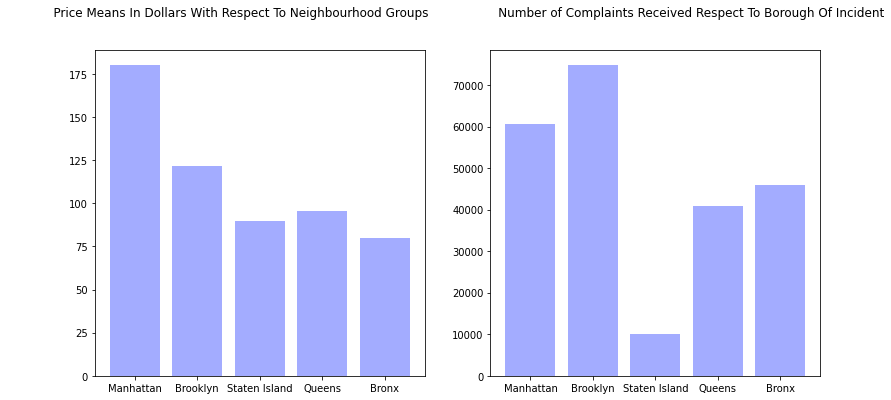

In [ ]:
list_of_brooklyn = df0.loc[df0['Borough Of Incident'] == 'Brooklyn']
num_brooklyn = len(list_of_brooklyn)

list_of_manhattan = df0.loc[df0['Borough Of Incident'] == 'Manhattan']
num_manhattan = len(list_of_manhattan)

list_of_bronx = df0.loc[df0['Borough Of Incident'] == 'Bronx']
num_bronx = len(list_of_bronx)

list_of_queens = df0.loc[df0['Borough Of Incident'] == 'Queens']
num_queens = len(list_of_queens)

list_of_statenisland = df0.loc[df0['Borough Of Incident'] == 'Staten Island']
num_statenisland = len(list_of_statenisland)

data_civillian = {'Manhattan': num_manhattan, 'Brooklyn': num_brooklyn, 'Staten Island': num_statenisland,'Queens': num_queens,  'Bronx': num_bronx}

names_civillian = list(data_civillian.keys())
values_civillian = list(data_civillian.values())

fig, axs = plt.subplots(1, 2, figsize=(13, 6)) 
axs[0].bar(names, values,color='#a3acff')
fig.suptitle('            Price Means In Dollars With Respect To Neighbourhood Groups                  Number of Complaints Received Respect To Borough Of Incident') 

axs[1].bar(names_civillian, values_civillian,color='#a3acff')

From our pricing distribution histogram we obtained the information that our **top priced** neighbourhood groups are **Manhattan** and **Brooklyn**. When we look at the histogram from **civillian complaints** we see that where the complaints are highest, prices are high too. We came to the conclusion that our initial hypothesis, being where the most complaints are, the prices will see a decline, has been rejected. 

<BarContainer object of 5 artists>

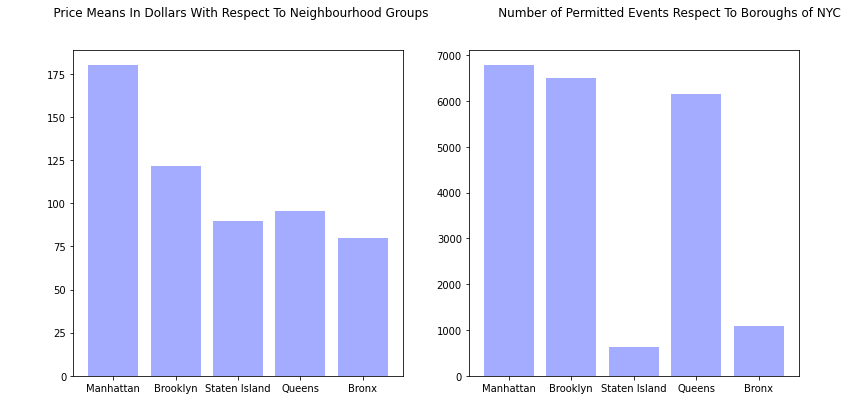

In [ ]:
list_of_brooklyn = df1.loc[df1['Event Borough'] == 'Brooklyn']
num_brooklyn = len(list_of_brooklyn)

list_of_manhattan = df1.loc[df1['Event Borough'] == 'Manhattan']
num_manhattan = len(list_of_manhattan)

list_of_bronx = df1.loc[df1['Event Borough'] == 'Bronx']
num_bronx = len(list_of_bronx)

list_of_queens = df1.loc[df1['Event Borough'] == 'Queens']
num_queens = len(list_of_queens)

list_of_statenisland = df1.loc[df1['Event Borough'] == 'Staten Island']
num_statenisland = len(list_of_statenisland)

data_permitted = {'Manhattan': num_manhattan, 'Brooklyn': num_brooklyn, 'Staten Island': num_statenisland,'Queens': num_queens,  'Bronx': num_bronx}

names_permitted = list(data_permitted.keys())
values_permitted = list(data_permitted.values())

fig, axs = plt.subplots(1, 2, figsize=(13, 6)) 
axs[0].bar(names, values,color='#a3acff')
fig.suptitle('            Price Means In Dollars With Respect To Neighbourhood Groups                  Number of Permitted Events Respect To Boroughs of NYC') 

axs[1].bar(names_permitted, values_permitted,color='#a3acff')


From the data we found out from our graph that represents the amount of permitted events per neighbourhood group, we came to the conclusion that the **top 2** neighbourhood groups which have the highest amount of events have a higher pricing range.

<BarContainer object of 5 artists>

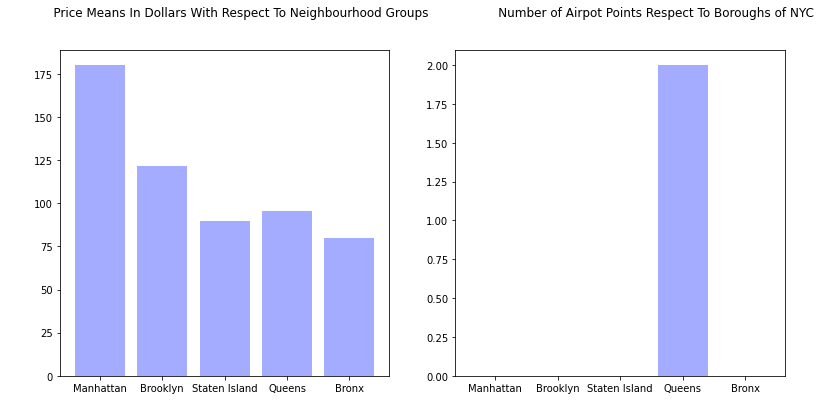

In [ ]:
data_airport = {'Manhattan': 0, 'Brooklyn': 0, 'Staten Island': 0,'Queens': 2,  'Bronx': 0}

names_airport = list(data_airport.keys())
values_airport = list(data_airport.values())

fig, axs = plt.subplots(1, 2, figsize=(13, 6)) 
axs[0].bar(names, values,color='#a3acff')
fig.suptitle('            Price Means In Dollars With Respect To Neighbourhood Groups                  Number of Airpot Points Respect To Boroughs of NYC') 

axs[1].bar(names_airport, values_airport,color='#a3acff')

From our plotted dataset of the number of airports each neighbourhood group has, we found out that only Queens has airports and none of the others do so we came to the conclusion that the airport status per neighbourhood group **hasn't been an impact on the pricings whatsoever.**

<BarContainer object of 5 artists>

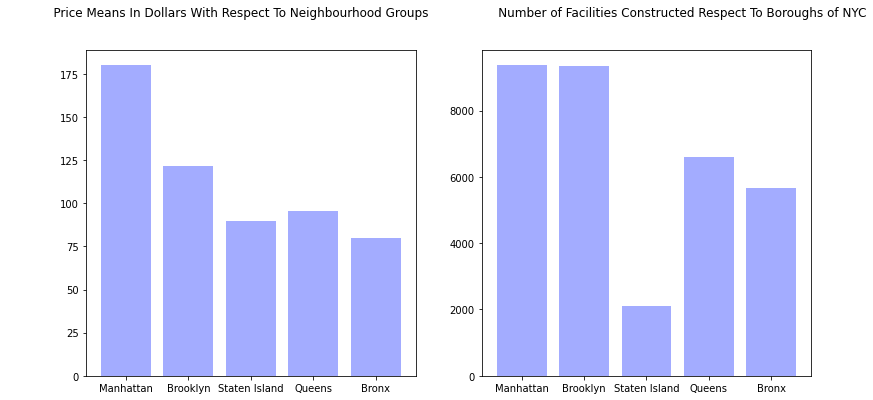

In [ ]:
list_of_brooklyn = df2.loc[df2['BORO'] == 'Brooklyn']
num_brooklyn = len(list_of_brooklyn)

list_of_manhattan = df2.loc[df2['BORO'] == 'Manhattan']
num_manhattan = len(list_of_manhattan)

list_of_bronx = df2.loc[df2['BORO'] == 'Bronx']
num_bronx = len(list_of_bronx)

list_of_queens = df2.loc[df2['BORO'] == 'Queens']
num_queens = len(list_of_queens)

list_of_statenisland = df2.loc[df2['BORO'] == 'Staten Island']
num_statenisland = len(list_of_statenisland)

data_facilities = {'Manhattan': num_manhattan, 'Brooklyn': num_brooklyn, 'Staten Island': num_statenisland,'Queens': num_queens,  'Bronx': num_bronx}

names_facilities = list(data_facilities.keys())
values_facilities = list(data_facilities.values())

fig, axs = plt.subplots(1, 2, figsize=(13, 6)) 
axs[0].bar(names, values,color='#a3acff')
fig.suptitle('            Price Means In Dollars With Respect To Neighbourhood Groups                  Number of Facilities Constructed Respect To Boroughs of NYC') 

axs[1].bar(names_facilities, values_facilities,color='#a3acff')

As we found out from our plotted data that represents the amount of **facilities** each neighbourhood group consists, this dataset is highly correlated with the pricing each neighbourhood has. The amount of facilities has clearly been an impact on the pricing distribution of each neighbourhood.

####[NYC Property Value](https://data.cityofnewyork.us/City-Government/Revised-Notice-of-Property-Value-RNOPV-/8vgb-zm6e/data) 

In [ ]:
path_prefix = "/content/drive/My Drive"
fname = "Revised_Notice_of_Property_Value__RNOPV_.csv"
df6 = pd.read_csv(join(path_prefix, fname))
  
df6.head()

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (29) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,MAILED DATE,BOROCODE,BLOCK,LOT,EASE,NAME,Address 1,Address 2,Address 3,"City, State, Zip",Country,TAX CLASS,BLD Class,ORIGINAL MARKET VALUE,ORIGINAL ASSESSED VALUE,ORIGINAL EXEMPTION,ORIGINAL TRANSITIONAL ASSESSED VALUE,ORIGINAL TRANSITIONAL EXEMPTION,ORIGINAL TAXABLE VALUE,REVISED MARKET VALUE,REVISED ASSESSED VALUE,REVISED EXEMPTION,REVISED TRANSITIONAL ASSESSED VALUE,REVISED TRANSITIONAL EXEMPTION,REVISED TAXABLE VALUE,RC 1,RC2,RC3,RC4,RC5,Borough,Postcode,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
0,02/23/2016,1,343,61,NaN,"KING, LINDA ...",,65 PITT ST,,NEW YORK NY 10002-3504,NaN,1.0,B2,2298000.0,62520.0,5690.0,0.0,0.0,56830.0,2758000.0,62520.0,5690.0,0.0,0.0,56830.0,M,,NaN,NaN,NaN,MANHATTAN,10002.0,40.717979,-73.982666,3.0,1.0,12.0,1077600.0,1.003430e+09,Lower East Side ...
1,02/23/2016,1,542,42,NaN,DIANA BURROUGHS ...,,155 JOHNSON RD,,FALLS VILLAGE CT 06031-1618,NaN,1.0,B1,4799000.0,96920.0,1550.0,0.0,0.0,95370.0,5718000.0,96920.0,1550.0,0.0,0.0,95370.0,M,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,02/23/2016,1,615,23,NaN,"FALCONE , MIMI SHERATON ...",,248 W 12TH ST,,NEW YORK NY 10014-1912,NaN,1.0,B9,9828000.0,140340.0,8450.0,0.0,0.0,131890.0,8859442.0,140340.0,8450.0,0.0,0.0,131890.0,M,,NaN,NaN,NaN,MANHATTAN,10014.0,40.737605,-74.002746,2.0,3.0,77.0,1011012.0,1.006150e+09,West Village ...
3,02/23/2016,1,631,26,NaN,271 WEST 10TH STREET LLC ...,,60 FERNWOOD RD,,SUMMIT NJ 07901-2954,NaN,1.0,A4,14102000.0,316209.0,0.0,0.0,0.0,316209.0,14624000.0,316209.0,0.0,0.0,0.0,316209.0,M,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,02/23/2016,1,717,63,NaN,438 WEST 20 STREET LLC ...,D. DAVIS,225 5TH AVE,OFC 3,NEW YORK NY 10010-1133,NaN,1.0,A4,7076000.0,321758.0,0.0,0.0,0.0,321758.0,9083000.0,321758.0,0.0,0.0,0.0,321758.0,M,,NaN,NaN,NaN,MANHATTAN,10010.0,40.743827,-73.987907,5.0,2.0,56.0,1087263.0,1.008568e+09,Hudson Yards-Chelsea-Flatiron-Union Square ...


In [ ]:
df6 = df6[['Borough', 'REVISED MARKET VALUE', 'BOROCODE']]
df6 = df6.dropna()
df6.head()

,Borough,REVISED MARKET VALUE,BOROCODE
0,MANHATTAN,2758000.0,1
2,MANHATTAN,8859442.0,1
4,MANHATTAN,9083000.0,1
5,MANHATTAN,10039000.0,1
6,MANHATTAN,14037000.0,1


In [ ]:
price_of_brooklyn_ = df6.loc[df6['BOROCODE'] == 3, 'REVISED MARKET VALUE']
mean_brooklyn_ = sum(price_of_brooklyn_)/len(price_of_brooklyn_)

price_of_manhattan_ = df6.loc[df6['Borough'] == 'MANHATTAN', 'REVISED MARKET VALUE']
mean_manhattan_ = sum(price_of_manhattan_)/len(price_of_manhattan_)

price_of_bronx_ = df6.loc[df6['BOROCODE'] == 2, 'REVISED MARKET VALUE']
mean_bronx_ = sum(price_of_bronx_)/len(price_of_bronx_)

price_of_queens_ = df6.loc[df6['BOROCODE'] == 4, 'REVISED MARKET VALUE']
mean_queens_ = sum(price_of_queens_)/len(price_of_queens_)

price_of_statenisland_ = df6.loc[df6['Borough'] == 'STATEN IS', 'REVISED MARKET VALUE']
mean_statenisland_ = sum(price_of_statenisland_)/len(price_of_statenisland_)

data_ = {'Manhattan': mean_manhattan_, 'Brooklyn': mean_brooklyn_,'Queens': mean_queens_, 'Staten Island': mean_statenisland_,  'Bronx': mean_bronx_}

names_ = list(data_.keys())
values_ = list(data_.values())

Since the data where the housing prices are shown and the pricing distributions of the airbnb data must be almost the same due to the properties being affected by the same terms such as transportations, amount of cafes, amount of events, reliability of the neighbourhood we want to test whether or not the hypothesis where Manhattan's overall property prices will actually be much bigger than the average of NYC boroughs resembling our initial Airbnb data.

$ H_0: $ μ = 2386354$

$ H_1: $ μ > 2386354$

In [ ]:
import statistics
sample_mean = mean_manhattan_
mean_to_be_tested = (mean_manhattan_ + mean_statenisland_ + mean_bronx_ + mean_brooklyn_ + mean_queens_)/5
std_dev = statistics.stdev(price_of_manhattan_)
sample_size = len(price_of_manhattan_)

t_score = (sample_mean - mean_to_be_tested) / (std_dev / (sample_size**0.5))
t_score


10.965962775218902

In [ ]:
from scipy import stats

df = sample_size-1
t = t_score
p = (stats.t.sf(abs(t),df))*2
p

7.761421382909994e-28

<font color="white">Since the P-value (7.761421382909994e-28) is less than the significance level (0.05), we cannot accept the null hypothesis. Thus, we must accept 𝐻𝐴 : Property pricing of Manhattan is the priciest of all the boroughs just like our initial airbnb data</font>

## Machine Learning Models

We decided to use regression models with our datasets. We thought it would be give better result because of our data types. Generally we had numerical data types and the ones which are object we changed them to int values. 

For example; 


In [ ]:
df['price_category']=df['price_category'].map({'low': 1,'low1': 2,'medium': 3,'medium1': 4,'medium high': 5,'medium high1': 6, 'high': 7,'high1': 8,'highest': 9,'highest1': 10})

The two regression models we chosed are:

1-DecisionTreeRegressor()

A decision tree are supervised machine learning algorithms which can be used for both classification and regression problems. The model we create is tree based; we divide (branch) the data into subsets over and over again.

2-RandomForestRegressor()

Like decision tree, Random Forest is supervised machine learning algorithms which can be used for both classification and regression problems. The model we create is Decision Trees based;we run many Decision Trees independently and aggregates the outputs with voting based approach(Bagging).




### Implementation


In [ ]:
import numpy as np
import pandas as pd
from os.path import join
import matplotlib.pyplot as plt

%matplotlib inline


In [ ]:
path_prefix = "/content/drive/My Drive"                      #a classic start 
fname = "AB_NYC_2019.csv"                                    # our airbnb dataset
df = pd.read_csv(join(path_prefix, fname))
df['neighbourhood_event'] = df['neighbourhood_group']        # This are newly created colums which will be used on later parts
df['neighbourhood_Facil'] = df['neighbourhood_group']        # of the code for Bourgh related datas processsed 
df['neighbourhood_comp'] = df['neighbourhood_group']         # by us in previous sections under the name of "Utilized Datasets"
df['neighbourhood_trans'] = df['neighbourhood_group']        #

def categorize(dfe):        # This function was made for categorizing our price column into smal ranges
   
    bins = [0,50, 100,150, 200,250, 300,350, 400,450, 10000]    # 99,9% of datas wre between 0-500 dollar so we let last part as 400+
    names = ['low','low1',  'medium', 'medium1', 'medium high','medium high1', 'high','high1', 'highest', 'highest1']
    a = pd.cut(dfe, bins= bins, labels=names)
    return a

df['price_category'] = df[['price']].apply(categorize)   # We created a new column to be used as label by using our function on price column.
df = df.dropna()

# We selected columns we want to use and created a new dataframe.
df = df[['price_category','neighbourhood_group','room_type','neighbourhood_event',
         'neighbourhood_Facil','neighbourhood_comp','neighbourhood_trans','latitude','longitude']]

# We can't work with NA values so we droped that rows, 
# it caused a little amount of data lost but wasn't big enough to cause much change to our accuracy.
df.dropna()

# Displays the look of our dataframe after cleaning and selection.
df.head()


,price_category,neighbourhood_group,room_type,neighbourhood_event,neighbourhood_Facil,neighbourhood_comp,neighbourhood_trans,latitude,longitude
0,medium,Brooklyn,Private room,Brooklyn,Brooklyn,Brooklyn,Brooklyn,40.64749,-73.97237
1,medium high,Manhattan,Entire home/apt,Manhattan,Manhattan,Manhattan,Manhattan,40.75362,-73.98377
3,low1,Brooklyn,Entire home/apt,Brooklyn,Brooklyn,Brooklyn,Brooklyn,40.68514,-73.95976
4,low1,Manhattan,Entire home/apt,Manhattan,Manhattan,Manhattan,Manhattan,40.79851,-73.94399
5,medium1,Manhattan,Entire home/apt,Manhattan,Manhattan,Manhattan,Manhattan,40.74767,-73.97500


In [ ]:
# Since we cannot use names for predictions, let's get rid of that column
# Also, we need to convert Sex column to a format that decision trees can accept

# This drops Name column
#df = df.drop(['Name'], axis = 1)

# This section will map objects to their related numeric values decided by us. Its a needed step to use object in regression. It will give better results with this datas.
#**********************************************************************************************************************************************************************************************************
df['neighbourhood_group'] = df['neighbourhood_group'].map({'Brooklyn': 0, 'Manhattan': 1,'Queens': 2, 'Staten Island': 3,'Bronx': 4})
df['room_type']= df['room_type'].map({'Private room': 0, 'Entire home/apt': 1, 'Shared room': 2})
df['neighbourhood_event'] = df['neighbourhood_event'].map({'Brooklyn': num_brooklyn1, 'Manhattan': num_manhattan1,'Queens': num_queens1, 'Staten Island': num_statenisland1,'Bronx': num_bronx1})
df['neighbourhood_Facil'] = df['neighbourhood_Facil'].map({'Brooklyn': num_brooklyn3, 'Manhattan': num_manhattan3,'Queens': num_queens3, 'Staten Island': num_statenisland3,'Bronx': num_bronx3})
df['neighbourhood_comp'] = df['neighbourhood_comp'].map({'Brooklyn': num_brooklyn2, 'Manhattan': num_manhattan2,'Queens': num_queens2, 'Staten Island': num_statenisland2,'Bronx': num_bronx2})
df['price_category']=df['price_category'].map({'low': 1,'low1': 2,'medium': 3,'medium1': 4,'medium high': 5,'medium high1': 6, 'high': 7,'high1': 8,'highest': 9,'highest1': 10})
df['neighbourhood_trans'] = df['neighbourhood_trans'].map({'Brooklyn': num_brooklyn4, 'Manhattan': num_manhattan4,'Queens': num_queens4, 'Staten Island': num_statenisland4,'Bronx': num_bronx4})
#**************************************************************************************************************************************************************************************************************

# Checking the dataframe again
df.head()

,price_category,neighbourhood_group,room_type,neighbourhood_event,neighbourhood_Facil,neighbourhood_comp,neighbourhood_trans,latitude,longitude
0,3,0,0,6496,9347,74777,5007,40.64749,-73.97237
1,5,1,1,6784,9367,60682,3350,40.75362,-73.98377
3,2,0,1,6496,9347,74777,5007,40.68514,-73.95976
4,2,1,1,6784,9367,60682,3350,40.79851,-73.94399
5,4,1,1,6784,9367,60682,3350,40.74767,-73.97500


In [ ]:
X = df.drop('price_category', axis=1) # these are features, (choseses columns other than 'price_category')
y = df['price_category']              # this is the target (what we want to predict)

In [ ]:
from sklearn.model_selection import train_test_split

# This will create train and test datasets from the original dataset that we have where
# 80% of original dataframe will be train set and 20% of it will be test set to evaluate the Decision Tree
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, test_size=0.20)

In [ ]:
print(X_train.shape, X_test.shape) # number of train and test datas we have

(31048, 8) (7763, 8)


In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression

# import models
#LinearRegression was not allowed to used as one of the 2 model we will use in the project but we used create variety while comaparing models.
ln = LinearRegression()                          
knn = KNeighborsRegressor(2)
dt = DecisionTreeRegressor()
rf = RandomForestRegressor(n_estimators=50)

# train part
ln.fit(X_train, y_train)
knn.fit(X_train, y_train)
dt.fit(X_train, y_train)
rf.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=50, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

[Regression model evaluation metrics;](https://www.datatechnotes.com/2019/02/regression-model-accuracy-mae-mse-rmse.html)

The **MSE**, **MAE**, **RMSE**, and **R-Squared** metrics are mainly used to evaluate the prediction error rates and model performance in regression analysis.

**MAE** (*Mean absolute error*) represents the difference between the original and predicted values extracted by averaged the absolute difference over the data set.

**MSE** (*Mean Squared Error*) represents the difference between the original and predicted values extracted by squared the average difference over the data set.

**RMSE** (*Root Mean Squared Error*) is the error rate by the square root of MSE.

**R-squared** (*Coefficient of determination*) represents the coefficient of how well the values fit compared to the original values. The value from 0 to 1 interpreted as percentages. The higher the value is, the better the model is.

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

y_pred = rf.predict(X_test)  # for RandomForestRegressor model

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mse)

print("mse: {}".format(mse)) 
print("mae: {}".format(mae))
print("rmse: {}".format(rmse))

mse: 2.2584809173143254
mae: 1.0022268023530423
rmse: 1.5028243135224841


Repeatation of previous cell for DecisionTreeRegression.

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

y_pred = dt.predict(X_test)   # for DecisionTreeRegressor model

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mse)

print("mse: {}".format(mse))
print("mae: {}".format(mae))
print("rmse: {}".format(rmse))

mse: 3.8937588561123277
mae: 1.223560479196187
rmse: 1.9732609700980577


Result for KNeighborsRegressor was close but not better than DecisionTreeRegressor and RandomForestRegressor. LinearRegression showed result a bit better than other regressors but we were not allowed to use.

After this, we could have done tuning for DecisionTreeRegressor and RandomForestRegressor but at this point it wouldn't much change so left their parameters as default.

### Results & Discussion

Display and discuss the results of your models. Deploy tables, figures etc. to present your results. Discuss the advantages/disadvantages of models compared to each other.


Great advantage of decision tree based models is that they can be very easy to interpret. This is because decision trees predict the value of a target variable (y) by learning simple decision rules inferred from the data features (X).

On the other hand, Random Forest can solve problems and limitations of Decision Trees. As the name suggests, Random Forest includes Decision Trees and based on random subset of features with bootstrapping approach.

As we can see from previous section, RandomForestRegressor showed better performance compared to DecisionTreeRegressor. RandomForestRegressor's **MSE**, **MAE**, **RMSE**, and **R-Squared** result were smaller than DecisionTreeRegressor. This time we focused on MAE values. We can interpreted it as number of errors we do. So we have did less error at RandomForestRegressor. 

**MSE**, **MAE**, **RMSE**, and **R-Squared** results for RandomForestRegressor;

mse: 2.2702514751313214

mae: 1.0062260723946927

rmse: 1.5067353699742105





**MSE**, **MAE**, **RMSE**, and **R-Squared** results for DecisionTreeRegressor;

mse: 3.8638735025119155

mae: 1.2214994203271932

rmse: 1.9656738036896955


Now we decided to use Correlation Matrix to further analyze our features and label.

A [correlation matrix](https://www.statisticshowto.com/correlation-matrix/) is a table showing correlation coefficients between sets of variables. Each random variable (Xi) in the table is correlated with each of the other values in the table (Xj). This allows you to see which pairs have the highest correlation.

With this we can understand what has an effect on another feature or on label. Which variables are related to each other or effects each other.

In [ ]:
corrMatrix = df.corr()  #A correlation matrix showing correlation coefficients for combinations of 9 variables.
print (corrMatrix)

                     price_category  neighbourhood_group  ...  latitude  longitude
price_category             1.000000            -0.025104  ...  0.054604  -0.282750
neighbourhood_group       -0.025104             1.000000  ...  0.532330   0.287077
room_type                  0.430756            -0.017133  ... -0.015444  -0.152625
neighbourhood_event        0.153852            -0.616618  ... -0.083569  -0.150750
neighbourhood_Facil        0.184401            -0.781415  ... -0.059319  -0.407394
neighbourhood_comp         0.025991            -0.914784  ... -0.386719  -0.255264
neighbourhood_trans       -0.112913            -0.844331  ... -0.583380   0.013099
latitude                   0.054604             0.532330  ...  1.000000   0.088300
longitude                 -0.282750             0.287077  ...  0.088300   1.000000

[9 rows x 9 columns]


**FOR BETTER VISUALIZATION:**

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


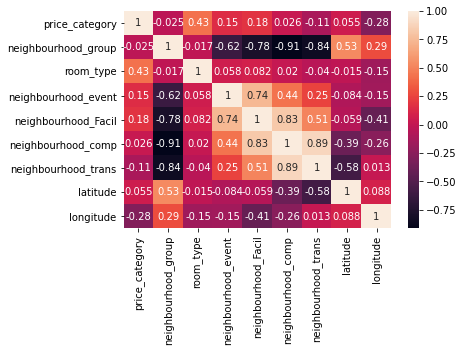

In [ ]:
import seaborn as sn
sn.heatmap(corrMatrix, annot=True)
plt.show()

As we can see from this matrix, neighbourhood_group have high values with neighbourhood_comp, neighbourhood_facil and neighbourhood_event. neighbourhood_group has a 0.53 value of correlation with laltitude which is related to specific areas of New York City. price_category also have a similiar relation with laltitude and neighboorhood_event. room_type has again similiar amount of correlati,on with price_category.

This will help us in future to further improve our machine learning performance.

## Conclusion

In our project what we wanted to find out was the components that made up the pricing values of Airbnb houses and why the Boroughs differed in pricing as seen in our data. As we plotted each dataset that we thought were relevant to pricing we have seen that the data which were most relevant were Civillian Complaints, NYC Transportation Sites data and the Facilities database whereas the least affecting data was the Airport points data we have looked into. Because of the types of datas we have and test results we have made, we decided to use RandomForestRegressor and DecisionTreeRegressor as a model. We created models that will help airbnb users to decide their housing prices. Our findings have been an advantage for a future price prediction where an Airbnb leasing is going to take place.